# Species Distribution Modeling -- Pitch Pine in the US Northeast
## Alejandro Rojas
## Gtech733 Final Project Draft

# Introduction
&emsp;Environmental conservation and management depends in large part knowing where certain species of flora or fauna occur. Biologists have been documenting and mapping the distribution of plants and animals for almost 200 years, although field samples still cannot cover the entire landscape. Additionally, anthropogenic and natural forces contribute to habitat change over time, making the full distribution of a species difficult to map and define. Recent advances in computing and statistics allows us to make use of field samples and other predictors for mapping of species habitat, using an approach called species distribution modeling (SDM).
    
&emsp;Species distribution modeling uses environmental data to predict the distribution of species across geographic space. SDMs originated as correlative models for ecologial niche modeling, which uses the presence of species at a geographic location, as well as environmental data for that location, to build multiple regression models. 
A species’ distribution is commonly characterized by either occurrence probability or population density. Logistic regression is widely used for SDM, since logistic regression can be used to predict categorical variables, like presence or absence. The resulting occurrence probability map predicts areas of high or low habitat suitability for the species being modeled, and can inform future research of these locations.

Species distribution modeling is based on the "fundamental niche" concept, or the range of environments where the species __could__ be found.
 - The fundamental niche is the range of environments within which a species can maintain a population that reproduces frequently enough that the population does not shrink.
 - The realized niche is the range of environments where the species is actually found. The realized niche is a subset of the fundamental niche.
    
&emsp;Using occurrence data from the Global Biodiversity Information Facility (GBIF) and environmental data from the WorldClim database, the purpose of this project is to model areas of predicted suitability for a species of pine tree called the Pitch Pine (Pinus Rigada) in the North East, U.S. Pitch pine is one of the species of pine that grows in the north eastern coastal pine forests, and has been under increasing strain from invasive species, habitat destruction, and other human-induced causes. For example, research shows that lower frequency of fires in pine forests negatively impacts their growth and reproduction rates. It is widely documented that it also puts them at risk of pine beetle outbreaks, which may accelerate the conversion of pitch pine-dominated forests to mixed oak-hardwood forests (Ledig, et al 1974). Modeling areas of pitch pine suitability, or the range of environements where the species could be found, will help inform management and conservation efforts.


In [118]:
%%html
<img src="./img/realNiche.jpg", width = 600, height = 600>
Citation: http://climatesmartnetwork.org/2015/07/certainty-and-uncertainty-in-climate-change-and-forest-response-part-2-the-forest-response/

## Regression Modeling in SDM
&emsp;Logsitic regression models are widely used in SDM, since the formula allows the relationship between environmental variables and presence/absence data to be modeled. Recent advances in computing and statistics allows for more complex modeling relationships to be implemented.

&emsp;Logistic regression is different from linear regression, because it can predict categorical variables, where in simple linear regression the dependent variable must be continuous. In SDM, the dependent variable is binary (only two categories). The absence/presence data is usually coded as 0 for absence and 1 for presence. The logistic regression equation is used to predict the habitat suitability of the landscape, based on envionment variables at those locations where the species is observed.

__The Logistic Curve Formula__
<br>P = 1 / (1 + e$^$-(a+bx))

### Machine Learning Models
&emsp;Machine learning models allows for much more complex relationships between the independent and dependent variables. Machine learning in logistic regression modeling uses the same logsitic curve formula equation, however, it includes more complicated equations to relate the independent variables to the dependent variable. This is done through a form of "data mining," where the computer looks for complex associations in the data that usually go unnoticed. In SDM, this usually involves applying the logistic regression formula to localized subsets of data.

## Loading and Cleaning Data

&emsp;The data used for this research comes from the Global Biodiversity Information Facility (GBIF) and the WorldClim database. GBIF aggregates data from various databases on biodiversity, with an emphasis on species occurrences (locations). The WorldClim database has high spatial resolution global weather and climate data, and this study will use the data from 1970 through 2000. Also, the USDA soil survey data will be used to include soil characteristics. The spatial scale for environmental variables used in this study will be 30 seconds (~1 km2).

&emsp;The dependent variable used in this model is occurence data for a species of pine tree called pinus rigada, commonly known as pitch pine. This data has geographic coordinates (WGS84) associated with each observation, which is necessary for SDM.

__The independent variables used in this study are:__

 - BIO1 = Annual Mean Temperature

 - BIO2 = Mean Diurnal Range (Mean of monthly (max temp - min temp))

 - BIO3 = Isothermality (BIO2/BIO7) (×100)

 - BIO4 = Temperature Seasonality (standard deviation ×100)

 - BIO15 = Precipitation Seasonality (Coefficient of Variation)

 - BIO_ELEV = SRTM elevation data (used to derive bioclimatic variables in worldClim)

In [1]:
# Load all the necessary libraries
import numpy as np
import pandas as pd
import geopandas as gpd
import descartes
import matplotlib.pyplot as plt
import shapely
import pyproj
import gdal
import os
import rasterio
import sklearn
from sklearn.linear_model import LogisticRegression

%matplotlib inline
# for ineractive plots, use:
# %matplotlib qt 

## Data cleaning through Geopandas and Rasterio
Note: I was unable to fully process and clean my data through python, so I used qgis to clip the rasters, then extracted raster values to points.
Please jump to section 1: Loading the Clean Data.
This part is still in progress to implement a full python spatial analysis project (from data processing to analysis)

In [2]:
## First, load and clip the images to the aoi shapefile

# set input and output paths for clips
inputPath = './data/bioclim/'
outputPath = './data/output/'

# Get a list of all the raster files in bioclim
bioList = [file for file in os.listdir(outputPath)]

# Load the shapefile AOI
aoi = './data/aoi.shp'

bioList

['bio_7_clip.tif',
 'bio_6_clip.tif',
 'bio_11_clip.tif',
 'bio_10_clip.tif',
 'bio_16_clip.tif',
 'bio_17_clip.tif',
 'bio_1_clip.tif',
 'bio_12_clip.tif',
 'bio_13_clip.tif',
 'elev_clip.tif',
 'bio_18_clip.tif',
 'bio_19_clip.tif',
 'bio_4_clip.tif',
 'bio_5_clip.tif',
 'bio_9_clip.tif',
 'bio_8_clip.tif',
 'bio_3_clip.tif',
 'bio_2_clip.tif',
 'bio_15_clip.tif',
 'bio_14_clip.tif']

In [22]:
## For each bioclim raster, clip to AOI with the GDAL warp function, and name it properly
for bio in bioList:
    print(outputPath + bio[10:-4]+'_clip'+bio[-4:]) #file names
    options = gdal.WarpOptions(cutlineDSName=aoi,cropToCutline=True)
    outBioVar = gdal.Warp(srcDSOrSrcDSTab=inputPath + bio,
                        destNameOrDestDS=outputPath + bio[10:-4]+'_clip'+bio[-4:],
                        options=options)
    outBioVar= None

./data/output/bio_1_clip.tif
./data/output/bio_10_clip.tif
./data/output/bio_11_clip.tif
./data/output/bio_12_clip.tif
./data/output/bio_13_clip.tif
./data/output/bio_14_clip.tif
./data/output/bio_15_clip.tif
./data/output/bio_16_clip.tif
./data/output/bio_17_clip.tif
./data/output/bio_18_clip.tif
./data/output/bio_19_clip.tif
./data/output/bio_2_clip.tif
./data/output/bio_3_clip.tif
./data/output/bio_4_clip.tif
./data/output/bio_5_clip.tif
./data/output/bio_6_clip.tif
./data/output/bio_7_clip.tif
./data/output/bio_8_clip.tif
./data/output/bio_9_clip.tif
./data/output/elev_clip.tif


In [3]:
## Clip the pitch pine points using the aoi shapefile
# Read in the aoi shapefile and pitch pine occurence points into geopandas dataframes
aoi_gdf = gpd.read_file(aoi)

pitch_pine_fp = './ppOccurences.shp'
pp_gdf = gpd.read_file(pitch_pine_fp)

print('AOI crs: ' + str(aoi_gdf.crs))
print('Pitch Pine layer crs: ' + str(pp_gdf.crs))

pp_gdf

AOI crs: epsg:4326
Pitch Pine layer crs: epsg:4326


,Name,State,decimalLat,decimalLon,year,geometry
0,Pinus rigida,Pennsylvania,40.799679,-77.989929,2014.0,POINT (-77.98993 40.79968)
1,Pinus rigida,New York,42.718943,-73.863771,2015.0,POINT (-73.86377 42.71894)
2,Pinus rigida,New York,40.586275,-73.559793,2015.0,POINT (-73.55979 40.58628)
3,Pinus rigida,New Jersey,39.887025,-74.379463,2015.0,POINT (-74.37946 39.88703)
4,Pinus rigida,Massachusetts,42.737980,-70.792906,2015.0,POINT (-70.79291 42.73798)
...,...,...,...,...,...,...
1497,Pinus rigida,Massachusetts,42.184689,-72.520340,2020.0,POINT (-72.52034 42.18469)
1498,Pinus rigida,Massachusetts,42.182919,-72.522156,2020.0,POINT (-72.52216 42.18292)
1499,Pinus rigida,New York,40.588745,-73.552703,2020.0,POINT (-73.55270 40.58875)
1500,Pinus rigida,New York,40.587417,-73.549103,2020.0,POINT (-73.54910 40.58742)


In [4]:
## Add a new column called "class" indicating presence or absence. Make all equal to 1 (since this is presence data)
pp_gdf.insert(2, "class", 1, True)
pp_gdf

,Name,State,class,decimalLat,decimalLon,year,geometry
0,Pinus rigida,Pennsylvania,1,40.799679,-77.989929,2014.0,POINT (-77.98993 40.79968)
1,Pinus rigida,New York,1,42.718943,-73.863771,2015.0,POINT (-73.86377 42.71894)
2,Pinus rigida,New York,1,40.586275,-73.559793,2015.0,POINT (-73.55979 40.58628)
3,Pinus rigida,New Jersey,1,39.887025,-74.379463,2015.0,POINT (-74.37946 39.88703)
4,Pinus rigida,Massachusetts,1,42.737980,-70.792906,2015.0,POINT (-70.79291 42.73798)
...,...,...,...,...,...,...,...
1497,Pinus rigida,Massachusetts,1,42.184689,-72.520340,2020.0,POINT (-72.52034 42.18469)
1498,Pinus rigida,Massachusetts,1,42.182919,-72.522156,2020.0,POINT (-72.52216 42.18292)
1499,Pinus rigida,New York,1,40.588745,-73.552703,2020.0,POINT (-73.55270 40.58875)
1500,Pinus rigida,New York,1,40.587417,-73.549103,2020.0,POINT (-73.54910 40.58742)


In [5]:
## Clip the pp_gdf with the aoi shapefile
# Fix error before draft
# use:
# pp_gdf.clip(aoi_gdf)

# Geopandas clip is not working, may be due to older Geopandas version
# After updating geopandas, this function still does not work
pp_clip = gpd.clip(pp_gdf, aoi_gdf)

In [6]:
pp_clip

,Name,State,class,decimalLat,decimalLon,year,geometry
0,Pinus rigida,Pennsylvania,1,40.799679,-77.989929,2014.0,POINT (-77.98993 40.79968)
1,Pinus rigida,New York,1,42.718943,-73.863771,2015.0,POINT (-73.86377 42.71894)
2,Pinus rigida,New York,1,40.586275,-73.559793,2015.0,POINT (-73.55979 40.58628)
3,Pinus rigida,New Jersey,1,39.887025,-74.379463,2015.0,POINT (-74.37946 39.88703)
4,Pinus rigida,Massachusetts,1,42.737980,-70.792906,2015.0,POINT (-70.79291 42.73798)
...,...,...,...,...,...,...,...
1496,Pinus rigida,New Jersey,1,39.763633,-74.106317,2020.0,POINT (-74.10632 39.76363)
1497,Pinus rigida,Massachusetts,1,42.184689,-72.520340,2020.0,POINT (-72.52034 42.18469)
1498,Pinus rigida,Massachusetts,1,42.182919,-72.522156,2020.0,POINT (-72.52216 42.18292)
1499,Pinus rigida,New York,1,40.588745,-73.552703,2020.0,POINT (-73.55270 40.58875)


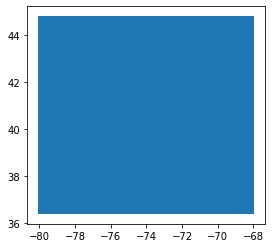

In [8]:
aoi_gdf.plot()

In [18]:
## Load in clipped pitch pine occurence points
fp = './ppOccurences_clip.shp'
pp_clipped = gpd.read_file(fp)
pp_clipped

,Name,State,decimalLat,decimalLon,year,type,geometry
0,Pinus rigida,Pennsylvania,40.799679,-77.989929,2014,1,MULTIPOINT (-77.98993 40.79968)
1,Pinus rigida,New York,42.718943,-73.863771,2015,1,MULTIPOINT (-73.86377 42.71894)
2,Pinus rigida,New York,40.586275,-73.559793,2015,1,MULTIPOINT (-73.55979 40.58628)
3,Pinus rigida,New Jersey,39.887025,-74.379463,2015,1,MULTIPOINT (-74.37946 39.88703)
4,Pinus rigida,Massachusetts,42.737980,-70.792906,2015,1,MULTIPOINT (-70.79291 42.73798)
...,...,...,...,...,...,...,...
1447,Pinus rigida,New Jersey,39.763633,-74.106317,2020,1,MULTIPOINT (-74.10632 39.76363)
1448,Pinus rigida,Massachusetts,42.184689,-72.520340,2020,1,MULTIPOINT (-72.52034 42.18469)
1449,Pinus rigida,Massachusetts,42.182919,-72.522156,2020,1,MULTIPOINT (-72.52216 42.18292)
1450,Pinus rigida,New York,40.588745,-73.552703,2020,1,MULTIPOINT (-73.55270 40.58875)


In [19]:
# Rename the "type" column to "class", indicating the presence/absence of an observation
# this is due to "type" being a reserved word in python, and can cause complications if we have a column or variable
# with the same name

pp_clipped.rename(columns={'type':'class'}, inplace=True)
pp_clipped

,Name,State,decimalLat,decimalLon,year,class,geometry
0,Pinus rigida,Pennsylvania,40.799679,-77.989929,2014,1,MULTIPOINT (-77.98993 40.79968)
1,Pinus rigida,New York,42.718943,-73.863771,2015,1,MULTIPOINT (-73.86377 42.71894)
2,Pinus rigida,New York,40.586275,-73.559793,2015,1,MULTIPOINT (-73.55979 40.58628)
3,Pinus rigida,New Jersey,39.887025,-74.379463,2015,1,MULTIPOINT (-74.37946 39.88703)
4,Pinus rigida,Massachusetts,42.737980,-70.792906,2015,1,MULTIPOINT (-70.79291 42.73798)
...,...,...,...,...,...,...,...
1447,Pinus rigida,New Jersey,39.763633,-74.106317,2020,1,MULTIPOINT (-74.10632 39.76363)
1448,Pinus rigida,Massachusetts,42.184689,-72.520340,2020,1,MULTIPOINT (-72.52034 42.18469)
1449,Pinus rigida,Massachusetts,42.182919,-72.522156,2020,1,MULTIPOINT (-72.52216 42.18292)
1450,Pinus rigida,New York,40.588745,-73.552703,2020,1,MULTIPOINT (-73.55270 40.58875)


In [10]:
# Get a list of all the raster files in bioclim

bioClim_path = './data/output'
bioClim_list = [file for file in os.listdir(bioClim_path)]

bioClim_list

['bio_7_clip.tif',
 'bio_6_clip.tif',
 'bio_11_clip.tif',
 'bio_10_clip.tif',
 'bio_16_clip.tif',
 'bio_17_clip.tif',
 'bio_1_clip.tif',
 'bio_12_clip.tif',
 'bio_13_clip.tif',
 'elev_clip.tif',
 'bio_18_clip.tif',
 'bio_19_clip.tif',
 'bio_4_clip.tif',
 'bio_5_clip.tif',
 'bio_9_clip.tif',
 'bio_8_clip.tif',
 'bio_3_clip.tif',
 'bio_2_clip.tif',
 'bio_15_clip.tif',
 'bio_14_clip.tif']

In [19]:
## Create a function to generate random points within the aoi (for psuedo-absence points necessary in SDM)

import random
from shapely.geometry import Point

def generate_random(number, polygon):
    list_of_points = []
    minx, miny, maxx, maxy = polygon.bounds
    counter = 0
    while counter < number:
        pnt = Point(random.uniform(minx, maxx), random.uniform(miny, maxy))
        if polygon.contains(pnt):
            list_of_points.append(pnt)
            counter += 1
    return list_of_points

# Use the list of points to create a data frame
# add a column called class, and give all those values 0 (indicating absence)
# and append to the pitch pine GeoDataFrame


In [20]:
### Extracting raster values using the clipped points shapefile
### Draft 1

# # Read used pp_clipped points to extract raster values to points
# pp_clipped.index = range(len(pp_clipped))
# for i in range(len(pp_clipped)):
#     coords = [(x,y) for x, y in zip(pp_clipped.geometry[i][0].x, pp_clipped.geometry[i][0].y)]


# for (bio, i) in zip(bioClim_list, range(len(bioClim_list))):
#     # Open the raster and store metadata
#     src = rasterio.open(bio)
#     # add new column for bioclim raster values
#     pp_clipped.insert(-1, "raster %d" % (i), [x[0] for x in src.sample(coords)]) 
#     # Sample the raster at every point location and store values in DataFrame
# #     pp_clipped['Raster Value'] = [x[0] for x in src.sample(coords)]

In [ ]:
### Extracting raster values using the clipped points shapefile
## IN PROGRESS:
## Unable to extract pixel values to points using rasterio sample function()

## Extracting raster values using the original point shapefile layer

# Read in pp_gdf points extract coordinates to a list
pp_gdf.index = range(len(pp_gdf))
coords = [(x,y) for x, y in zip(pp_gdf.geometry.x, pp_gdf.geometry.y)]


for (bio, i) in zip(bioClim_list, range(len(bioClim_list))):
    # Open the raster and store metadata
    src = rasterio.open(bioClim_path + "/" + bio)
    # add new column for bioclim raster values, and include raster values sampled at coordinate points
    pp_gdf.insert(-1, "raster %d" % (i), [x[0] for x in src.sample(coords)])

# 1. Loading the Clean Data
### Pitch Pine location data and extracted raster values from QGIS generated shapefile


In [2]:
## Loading the clean pitch pine data (with psuedo absence points) generated in qgis

# Load in absence/presence pitch pine data with extracted raster values
pp_fp = './ppPts_rasterValues_clean.shp'
pp_data = gpd.read_file(pp_fp)

pp_data

,decimalLon,decimalLat,class,Name,State,year,bio_elev,bio10,bio11,bio12,...,bio1,bio2,bio3,bio4,bio5,bio6,bio7,bio8,bio9,geometry
0,-74.508807,43.595601,0,None,None,NaN,832.0,15.50000,-9.26667,1328.0,...,3.56250,11.34167,28.93282,1011.54724,22.4,-16.8,39.2,14.68333,-3.96667,POINT (-74.50881 43.59560)
1,-69.790372,40.758963,0,None,None,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-69.79037 40.75896)
2,-77.816820,39.717361,0,None,None,NaN,141.0,22.66667,0.23333,972.0,...,11.63750,12.09167,33.40239,907.44678,30.2,-6.0,36.2,20.53333,0.23333,POINT (-77.81682 39.71736)
3,-68.473367,38.384205,0,None,None,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-68.47337 38.38420)
4,-73.621319,40.947836,0,None,None,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-73.62132 40.94784)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2197,-74.106317,39.763633,1,Pinus rigida,New Jersey,2020.0,2.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-74.10632 39.76363)
2198,-72.520340,42.184689,1,Pinus rigida,Massachusetts,2020.0,70.0,21.36667,-2.83333,1139.0,...,9.52917,12.90833,32.51469,977.25140,29.7,-10.0,39.7,14.26667,-1.73333,POINT (-72.52034 42.18469)
2199,-72.522156,42.182919,1,Pinus rigida,Massachusetts,2020.0,74.0,21.45000,-2.81667,1143.0,...,9.57083,12.92500,32.47488,980.28857,29.8,-10.0,39.8,14.33333,-1.71667,POINT (-72.52216 42.18292)
2200,-73.552703,40.588745,1,Pinus rigida,New York,2020.0,2.0,22.68333,1.03333,1056.0,...,11.90000,8.40000,26.08696,878.82416,28.1,-4.1,32.2,10.33333,20.13333,POINT (-73.55270 40.58875)


In [3]:
# Drop NA values (these are the psuedo-random absence points that were generated in QGIS and were placed in the ocean)
pp_df = pp_data[pp_data['bio11'].notna()]
pp_df = pp_df[pp_df['bio_elev'].notna()]
pp_df.shape

pp_df

,decimalLon,decimalLat,class,Name,State,year,bio_elev,bio10,bio11,bio12,...,bio1,bio2,bio3,bio4,bio5,bio6,bio7,bio8,bio9,geometry
0,-74.508807,43.595601,0,None,None,NaN,832.0,15.50000,-9.26667,1328.0,...,3.56250,11.34167,28.93282,1011.54724,22.4,-16.8,39.2,14.68333,-3.96667,POINT (-74.50881 43.59560)
2,-77.816820,39.717361,0,None,None,NaN,141.0,22.66667,0.23333,972.0,...,11.63750,12.09167,33.40239,907.44678,30.2,-6.0,36.2,20.53333,0.23333,POINT (-77.81682 39.71736)
5,-72.059668,41.651385,0,None,None,NaN,77.0,20.25000,-1.81667,1239.0,...,9.40000,11.46667,31.85185,898.03070,27.5,-8.5,36.0,5.83333,17.60000,POINT (-72.05967 41.65138)
6,-78.538243,44.066245,0,None,None,NaN,275.0,18.26667,-6.71667,960.0,...,6.17500,9.68333,25.54969,1016.21289,25.2,-12.7,37.9,8.08333,-5.85000,POINT (-78.53824 44.06625)
7,-76.371733,39.521086,0,None,None,NaN,72.0,23.08333,0.98333,1139.0,...,12.20000,10.38333,30.18411,894.91241,29.7,-4.7,34.4,20.85000,2.00000,POINT (-76.37173 39.52109)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2196,-72.521263,42.185974,1,Pinus rigida,Massachusetts,2020.0,70.0,21.45000,-2.81667,1143.0,...,9.57083,12.92500,32.47488,980.28857,29.8,-10.0,39.8,14.33333,-1.71667,POINT (-72.52126 42.18597)
2198,-72.520340,42.184689,1,Pinus rigida,Massachusetts,2020.0,70.0,21.36667,-2.83333,1139.0,...,9.52917,12.90833,32.51469,977.25140,29.7,-10.0,39.7,14.26667,-1.73333,POINT (-72.52034 42.18469)
2199,-72.522156,42.182919,1,Pinus rigida,Massachusetts,2020.0,74.0,21.45000,-2.81667,1143.0,...,9.57083,12.92500,32.47488,980.28857,29.8,-10.0,39.8,14.33333,-1.71667,POINT (-72.52216 42.18292)
2200,-73.552703,40.588745,1,Pinus rigida,New York,2020.0,2.0,22.68333,1.03333,1056.0,...,11.90000,8.40000,26.08696,878.82416,28.1,-4.1,32.2,10.33333,20.13333,POINT (-73.55270 40.58875)


In [4]:
# Select only variables needed for analysis (review literature)
pp_clean = pp_df[['decimalLon', 'decimalLat', 'geometry', 'bio1', 'bio2', 'bio3', 'bio4', 'bio15', 'bio_elev', 'class']]
                 
print(pp_clean["bio1"].shape)
pp_clean

(1801,)


,decimalLon,decimalLat,geometry,bio1,bio2,bio3,bio4,bio15,bio_elev,class
0,-74.508807,43.595601,POINT (-74.50881 43.59560),3.56250,11.34167,28.93282,1011.54724,10.79591,832.0,0
2,-77.816820,39.717361,POINT (-77.81682 39.71736),11.63750,12.09167,33.40239,907.44678,13.03121,141.0,0
5,-72.059668,41.651385,POINT (-72.05967 41.65138),9.40000,11.46667,31.85185,898.03070,6.89441,77.0,0
6,-78.538243,44.066245,POINT (-78.53824 44.06625),6.17500,9.68333,25.54969,1016.21289,16.49641,275.0,0
7,-76.371733,39.521086,POINT (-76.37173 39.52109),12.20000,10.38333,30.18411,894.91241,12.14583,72.0,0
...,...,...,...,...,...,...,...,...,...,...
2196,-72.521263,42.185974,POINT (-72.52126 42.18597),9.57083,12.92500,32.47488,980.28857,6.99240,70.0,1
2198,-72.520340,42.184689,POINT (-72.52034 42.18469),9.52917,12.90833,32.51469,977.25140,6.97905,70.0,1
2199,-72.522156,42.182919,POINT (-72.52216 42.18292),9.57083,12.92500,32.47488,980.28857,6.99240,74.0,1
2200,-73.552703,40.588745,POINT (-73.55270 40.58875),11.90000,8.40000,26.08696,878.82416,13.29456,2.0,1


## Visualize the Bioclim Raster Inputs

The bioclim raster files are the main inputs for the species distribution model, which will allow us to plot habitat suitability spatially. The variables selected for this research aligned with the literature on pinus rigada, namely, their high tolerance for drastic changes in temperature and precipitation. This could be correlated to other varibales which are not included in the study, like soil type.

In [5]:
# Visualize the clipped rasters that are used as the explanatory (independent) variables
from PIL import Image
# First, load the data
# set input path to the clipped rasters
bioInput = './data/output/'

# Get a list of all the raster files in bioclim
bioVarList = [file for file in os.listdir(bioInput)]

# Method 1: use a for loop to loop through biolist rasters and stack the variables used in analysis

# Method 2: Open each individual raster file used in analysis and stack them together
bio1_pil = Image.open(bioInput + 'bio_1_clip.tif')
bio2_pil = Image.open(bioInput + 'bio_2_clip.tif')
bio3_pil = Image.open(bioInput + 'bio_3_clip.tif')
bio4_pil = Image.open(bioInput + 'bio_4_clip.tif')
bio15_pil = Image.open(bioInput + 'bio_15_clip.tif')
bio_elev_pil = Image.open(bioInput + 'elev_clip.tif')

# Convert each band into a numpy array
bio1_arr = np.array(bio1_pil)
bio2_arr = np.array(bio2_pil)
bio3_arr = np.array(bio3_pil)
bio4_arr = np.array(bio4_pil)
bio15_arr = np.array(bio15_pil)
bio_elev_arr = np.array(bio_elev_pil)

In [6]:
# Set NA values to the bioclim rasters (all NA values are -3.4e+38 for bioclim variables, while elevation is -32768)

# set the values to NA for bioclim variables
bio1_arr[bio1_arr < 0] = np.nan
bio2_arr[bio2_arr < 0] = np.nan
bio3_arr[bio3_arr < 0] = np.nan
bio4_arr[bio4_arr < 0] = np.nan
bio15_arr[bio15_arr < 0] = np.nan

# set na values for the elevation raster
bio_elev_arr = bio_elev_arr.astype('float')
bio_elev_arr[bio_elev_arr == (-32768)] = np.nan

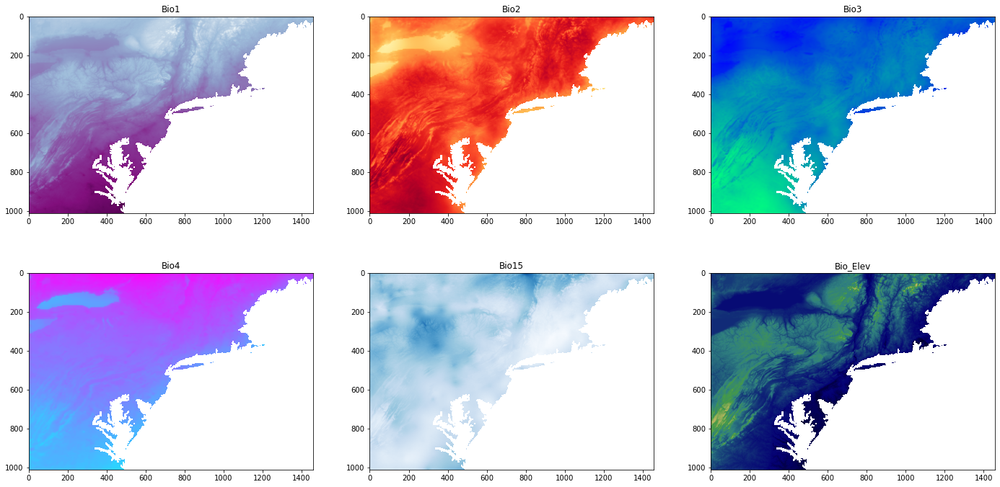

In [7]:
# Display image variables
# use the following magic line to render interactive plots to a window output
# %matplotlib qt

# Dont forget to switch back to normal magic afterwards!
%matplotlib inline

fig=plt.figure(figsize=(24,12))

# display bio1
a = fig.add_subplot(2,3,1)
bio1_plot = plt.imshow(bio1_arr, cmap="BuPu")
a.set_title('Bio1')

# display bio2
a = fig.add_subplot(2,3,2)
bio2_plot = plt.imshow(bio2_arr, cmap = 'YlOrRd')
a.set_title('Bio2')

# display bio3
a = fig.add_subplot(2,3,3)
bio3_plot = plt.imshow(bio3_arr, cmap='winter')
a.set_title('Bio3')

# display bio4
a = fig.add_subplot(2,3,4)
bio4_plot = plt.imshow(bio4_arr, cmap='cool')
a.set_title('Bio4')

# display bio15
a = fig.add_subplot(2,3,5)
bio15_plot = plt.imshow(bio15_arr, cmap='Blues')
a.set_title('Bio15')

# display bio_elev
a = fig.add_subplot(2,3,6)
bio_elev_plot = plt.imshow(bio_elev_arr, cmap="gist_earth")
a.set_title('Bio_Elev')

plt.show()

## Plot the DEM with Pitch Pine location points

This allows us to visually inspect for any spatial distributions patterns.

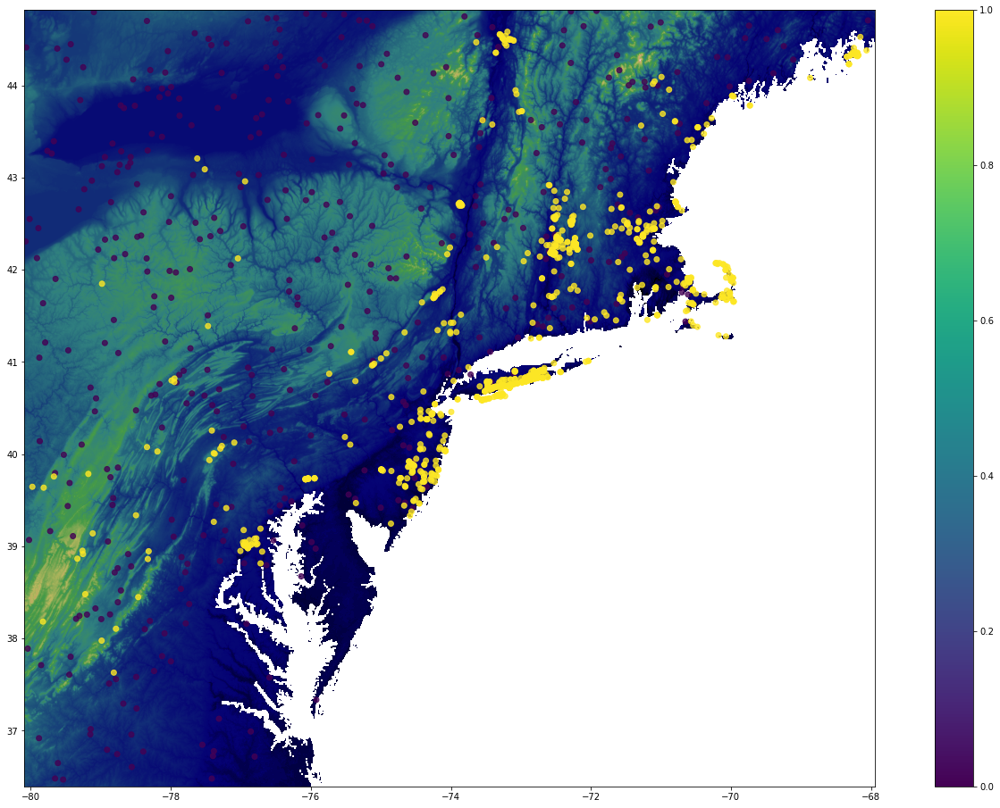

In [9]:
# Plot raster DEM then overlay pitch pine points
# use the matplotlib qt magic for pan and zoom capabilities
# %matplotlib qt
%matplotlib inline

fig, ax = plt.subplots(figsize=(24, 16))
rst = rasterio.open('./data/output/elev_clip.tif')
rst_bioElev = rst.read(1)
bounds = (rst.bounds.left, rst.bounds.right, \
      rst.bounds.bottom, rst.bounds.top)

rst_bioElev = rst_bioElev.astype('float')
rst_bioElev[rst_bioElev == (-32768)] = np.nan

ax.imshow(rst_bioElev, extent=bounds, cmap = 'gist_earth')
pp_clean.plot(column='class',ax=ax, alpha=0.8, legend=True)

# 2. Exploratory Data Analysis

The purpose of the exploratory data analysis is to make sure that the underlying assumptions of a logistic regression are met. Mainly, that there is no collinearity between the predictor variables. In this case, there seems to be strong colinearity between predictors, and a PCA should be performed to remove collinearity and strengthen the model.
The variables that do not display collinearity together are bio3 (isothermality), bio4 (temperature seasonality), and bio_elev (elevation).

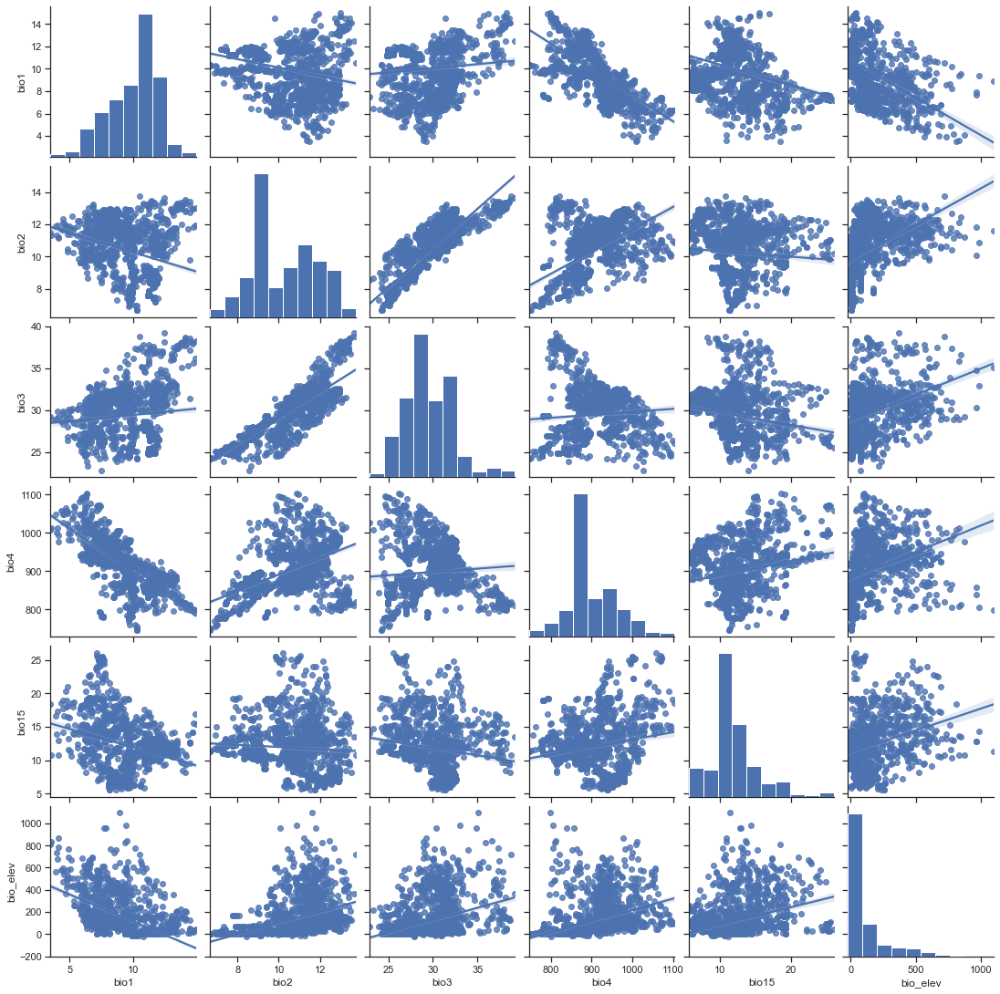

In [10]:
# Use a multi pairs plot for visual check on collinearity between independent variables

import seaborn as sns; sns.set(style="ticks", color_codes=True)

g = sns.pairplot(pp_clean.iloc[:,3:-1], kind='reg')

## Visualize a scatter plot of the three variables with least collinearity
 - Bio3 (isothermality)
 - Bio4 (temperature seasonality)
 - Bio_elev (elevation)
 
The scatter plot highlights that pitch pine observations are more concentrated in the lower elevations, and we can confirm that with our map above. It is also clearly visible from our map that there are more observations along the coastal plain, but a careful eye would also notice that they are along the connecticut river and other low-lying basins. In fact, many of the pitch pine observations along the coast are part of, or connected too, the pine barren reserves of New Jersey, Long Island, or Cape Cod.

Text(0.5, 0, 'Elevation')

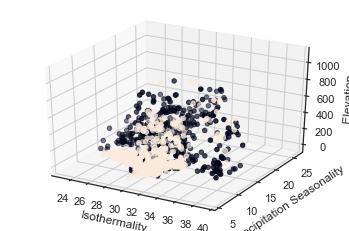

In [26]:
# Plot 3D map

from mpl_toolkits.mplot3d import Axes3D
# Use the matplotlib qt magic for pan and zoom capabilities!
# %matplotlib qt
%matplotlib inline

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

X3d = pp_clean[['bio3', 'bio15', 'bio_elev', 'class']]
XD = X3d.values

ax.scatter(XD[:,0], XD[:,1], XD[:,2], c = XD[:,3], marker='o')
ax.set_xlabel('Isothermality')
ax.set_ylabel('Precipitation Seasonality')
ax.set_zlabel('Elevation')

# 3. Training and Testing the Model

## Regression Modeling in SDM
&emsp;Logistic regression models are widely used in SDM, since the formula allows the relationship between environmental variables and presence/absence data to be modeled. Recent advances in computing and statistics allows for more complex modeling relationships to be implemented.

&emsp;Logistic regression is different from linear regression, because it can predict categorical variables, where in simple linear regression the dependent variable must be continuous. In SDM, the dependent variable is binary (only two categories). The absence/presence data is usually coded as 0 for absence and 1 for presence. The logistic regression equation is used to predict the habitat suitability of the landscape, based on envionment variables at those locations where the species is observed.

__The Logistic Curve Formula__
<br>P = 1 / (1 + e$^$-(a+bx))

### Machine Learning Models
&emsp;Machine learning models allows for much more complex relationships between the independent and dependent variables. Machine learning in logistic regression modeling uses the same logsitic curve formula equation, however, it includes more complicated equations to relate the independent variables to the dependent variable. This is done through a form of "data mining," where the computer looks for complex associations in the data that usually go unnoticed. In SDM, this usually involves applying the logistic regression formula to localized subsets of data.

In [116]:
%%html
<img src="./img/log_reg_sdm.png">
Citation: unknown

## Splitting the data into test, train datasets

In [31]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split


# Fit a logistic regression model using two select bioclim variables for visualization purposes

# First, split into test train data sets using the train_test_split function from scikit_learn
X = pp_clean[["bio4", "bio_elev"]]
Y = pp_clean['class']

x_train, x_test, y_train, y_test = train_test_split(X, Y, random_state=4)
print(X.shape)
print(Y.shape)
print(x_train.shape)
print(y_train.shape)

(1801, 2)
(1801,)
(1350, 2)
(1350,)


## Plot the probability results for training, then testing datasets
For visualization purposes, we can plot the bio elevation and the probability function to analyze where the predicted probability is low and high. Remember, for species distributiom modeling, this translate to the habitat suitability. Also, this research is finding the habitat suitability for the fundamental niche, not the realized niche, which would require inputs like land use.
The "s-curves", or logistic probability functions, show that the habititat suitability for pitch pine is highest in the low elevations, and drastically lowers as elevatio increases. In fact, at 220 meters, there is less than a .5 suitability for pitch pine. In binary logistic regression, the cutoff threshold is usually 0.5, where anything equal to or higher is classified as 1.

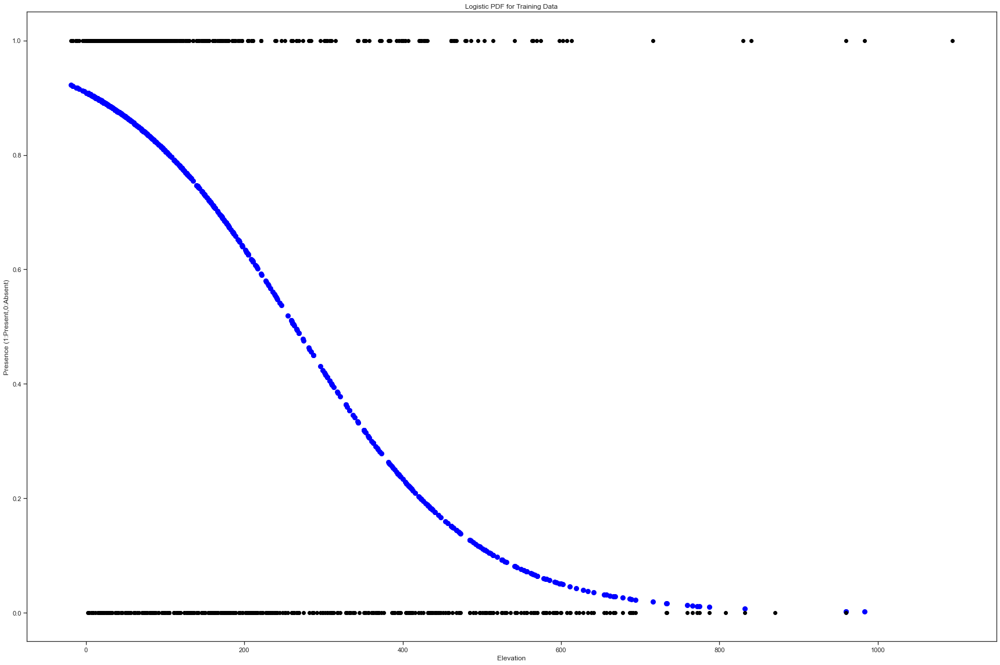

In [32]:
## Plot TRAINING data probability logistic curve for elevation
## Method 1
%matplotlib inline

fig, ax = plt.subplots(figsize=(24, 16))

# get input column values into numpy array for analysis
dfBioElev = pp_clean[["bio_elev"]]
xScatter = dfBioElev.rename_axis('ID').values

dfClass = pp_clean[["class"]]
yScatter = dfClass.rename_axis('ID').values

# fit the classifier
logreg = LogisticRegression()
logreg.fit(x_train[['bio_elev']], y_train)

# and plot the result
ax.scatter(xScatter.ravel(), yScatter.ravel(), color='black', zorder=20)
# X_test = np.linspace(-5, 10, 300)

x_trainArr = x_train[['bio_elev']].rename_axis('ID').values
xTrainRav = x_trainArr.ravel()

predicted_proba = logreg.predict_proba(x_trainArr)
predProbArr = predicted_proba[:,1].reshape(x_trainArr.shape)

# calculate the logit pdf and plot
plt.scatter(xTrainRav, predProbArr.ravel(), color='blue', linewidth=3)

# add plot elements
plt.ylabel('Presence (1:Present,0:Absent)')
plt.xlabel('Elevation')
plt.title('Logistic PDF for Training Data')
plt.tight_layout()
plt.show()


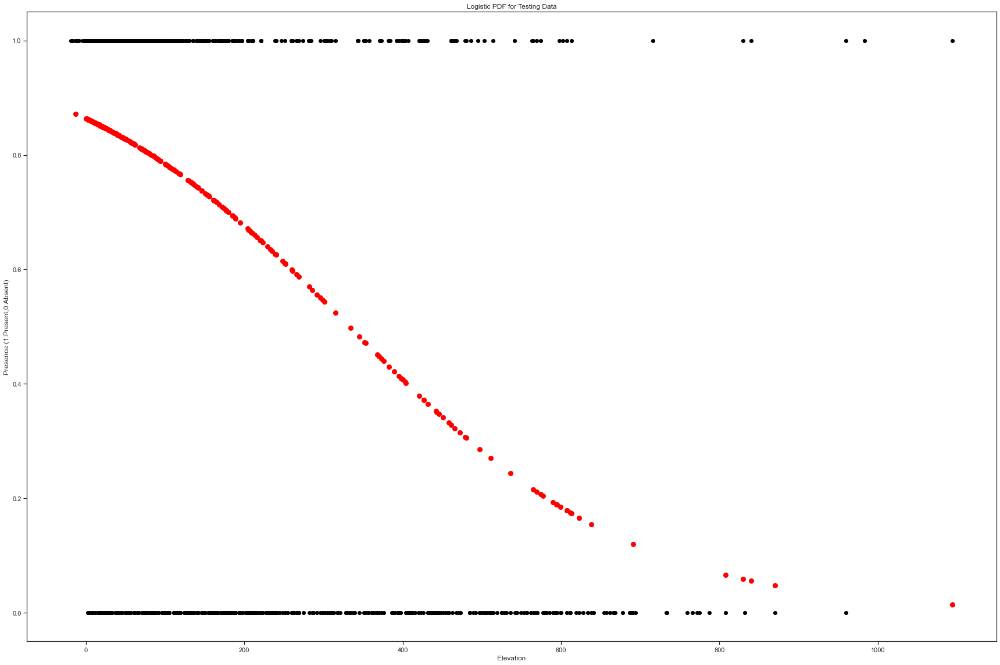

In [33]:
## Plot TESTING data probability logistic curve for elevation
## Method 1

fig, ax = plt.subplots(figsize=(24, 16))

# get input column values into numpy array for analysis
dfBioElev = pp_clean[["bio_elev"]]
xScatter = dfBioElev.rename_axis('ID').values

dfClass = pp_clean[["class"]]
yScatter = dfClass.rename_axis('ID').values

# fit the classifier
logreg = LogisticRegression()
logreg.fit(x_test[['bio_elev']], y_test)

# and plot the result
ax.scatter(xScatter.ravel(), yScatter.ravel(), color='black', zorder=20)
# X_test = np.linspace(-5, 10, 300)

x_testArr = x_test[['bio_elev']].rename_axis('ID').values
xTestRav = x_testArr.ravel()

predicted_proba = logreg.predict_proba(x_testArr)
predProbArr = predicted_proba[:,1].reshape(x_testArr.shape)

# calculate the logit pdf and plot
plt.scatter(xTestRav, predProbArr.ravel(), color='red', linewidth=3)

# add plot elements
plt.ylabel('Presence (1:Present,0:Absent)')
plt.xlabel('Elevation')
plt.xlabel('Elevation')
plt.title('Logistic PDF for Testing Data')
plt.tight_layout()
plt.show()


In [14]:
# ## Plot probability logistic curve for elevation
# ## Method 2

# from scipy.special import expit

# fig, ax = plt.subplots(figsize=(24, 16))

# # get input column values into numpy array for analysis
# dfBioElev = pp_clean[["bio_elev"]]
# xScatter = dfBioElev.rename_axis('ID').values

# dfClass = pp_clean[["class"]]
# yScatter = dfClass.rename_axis('ID').values

# # fit the classifier
# logreg = LogisticRegression()
# logreg.fit(x_test[['bio_elev']], y_test)

# # and plot the result
# ax.scatter(xScatter.ravel(), yScatter.ravel(), color='black', zorder=20)
# # X_test = np.linspace(-5, 10, 300)

# x_testArr = x_test[['bio_elev']].rename_axis('ID').values
# # calculate the logit pdf and plot
# loss = expit(x_testArr.ravel() * logreg.coef_ + logreg.intercept_).ravel()
# plt.scatter(x_testArr.ravel(), loss, color='red', linewidth=3)

# plt.ylabel('Presence (1:Present,0:Absent)')
# plt.xlabel('X')
# plt.tight_layout()
# plt.show()

In [34]:
# Read the column names to select the ones you need for the regression analysis(in this case its 3:-1)
pp_clean.columns[3:-1]

Index(['bio1', 'bio2', 'bio3', 'bio4', 'bio15', 'bio_elev'], dtype='object')

## Evaluation Metrics
### Precision and Recall

Precision means the percentage of your results which are relevant. On the other hand, recall refers to the percentage of total relevant results correctly classified by your model.

In [30]:
%%html
<img src='./img/prec_recall.png'>
Citation: https://towardsdatascience.com/precision-vs-recall-386cf9f89488

In [35]:
# Use logistic funciton on all selected bio clim variables
# First, split into test train data sets using the train_test_split function from scikit_learn
X = pp_clean[pp_clean.columns[3:-1]]
Y = pp_clean['class']

x_train, x_test, y_train, y_test = train_test_split(X, Y, random_state=4)

# Train the model, then predict using the x_test
logreg = LogisticRegression()
logreg.fit(x_train, y_train)

# logreg.get_params()

LogisticRegression()

## Finding the mean accuracy of correct predictions in both the training and testing datasets
### The mean accuracy is the percentage of correct predictions by the model for the training and testing datasets.
The prediction accuracy for the training and testing datasets were about 83% and 77%, respectively.

In [36]:
# Calculate the mean accuracy on training data and labels
acc = logreg.score(x_train, y_train)
print("Training data accuracy: {0}".format(acc * 100))


# Calculate the mean accuracy on test data and labels
acc = logreg.score(x_test, y_test)
print("Testing data accuracy: {0}".format(acc * 100))

Training data accuracy: 82.66666666666667
Testing data accuracy: 77.38359201773835


In [41]:
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

# What is the precision and recall of the results, comparing the reference Y to the predicted Y:
y_pred = logreg.predict(x_test)
p = precision_score(y_test, y_pred, average=None)
r = recall_score(y_test, y_pred, average=None)

# Note that, with average set to None, precision and recall are calculated for each class
print("Precision:\n\tClass 0: {0}, Class 1: {1}\nRecall:\n\tClass 0: {2}, Class 1: {3}".format(p[0], p[1], r[0], r[1]))

Precision:
	Class 0: 0.575, Class 1: 0.816711590296496
Recall:
	Class 0: 0.40350877192982454, Class 1: 0.8991097922848664


## Plotting the ROC and AUC Curve
### The ROC curve is a plot of the values of sensitivity against one minus specificity
As well as being well calibrated, our model should also have a high discrimination ability. This means that observations with Y=1 ought to be predicted high probabilities, while those with Y=0 should to be assigned low probabilities. 
- The sensitivity is defined as the probability of the model predicting an observation as 'true positive,' or correctly classified (Y=1)
- Conversely, the specificity is the probability of the model predicting 'true negative' given that the observation is classified 'negative' (Y=0)
<br>
<br>
A model with high discrimination ability will have high sensitivity and specificity simultaneously, leading to an ROC curve which goes close to the top left corner of the plot (90 degree angle). A model with no discrimination ability will have an ROC curve which is the 45 degree diagonal line.
<br>
<br>
In our SDM, we can see that the AUC of the ROC is 0.829, which signifies a high degree of separability between the two classes being predicted. 

No Skill: ROC AUC=0.500
Logistic: ROC AUC=0.829


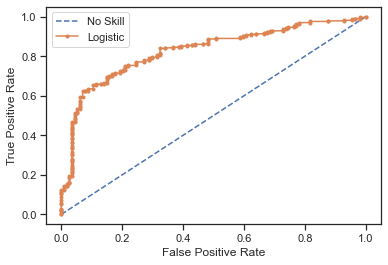

In [43]:

# roc curve and auc
from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt

logreg = LogisticRegression()
logreg.fit(x_train, y_train)
lr_probs = logreg.predict_proba(x_test)
# keep probabilities for the positive outcome only
lr_probs = lr_probs[:, 1]
# calculate scores
# generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

ns_auc = roc_auc_score(y_test, ns_probs)
lr_auc = roc_auc_score(y_test, lr_probs)
# summarize scores
print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic: ROC AUC=%.3f' % (lr_auc))
# calculate roc curves
y_pred = logreg.predict(x_test)
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
# plot the roc curve for the model
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='Logistic')
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend
plt.legend()
# show the plot
plt.show()

In [44]:
# Stack all arrays into one numpy array to use for analysis
bio_stack = np.dstack((bio1_arr, bio2_arr, bio3_arr, bio4_arr, bio15_arr, bio_elev_arr))

print("Stacked array shape size: {0}".format(bio_stack.shape))

# Create an empty target raster
result = np.zeros(bio_stack[:, :, 0].shape)
print("Empty raster shape to store results: {0}".format(result.shape))

Stacked array shape size: (1011, 1458, 6)
Empty raster shape to store results: (1011, 1458)


# 4. Predicting probability of presence using out of sample data
Predicting out of sample data using the fitted logistic regression model.
<br>
The values at each pixel from all the bands will be used as the input, and the class for the pixel is then predicted.
## Using the selected rasters as input for a per-pixel logistic regression

In [45]:
# initialize an array to add labeled pixels
result = np.zeros(bio_stack[:, :, 0].shape)
for j in range(bio_stack.shape[0]):
    print(j)
    for k in range(bio_stack.shape[1]):
        # for all band values (each raster value) in a pixel
        b_array = bio_stack[j,k,:]
        if (np.all(np.isnan(b_array))):
            continue
        else:
            # add band values to list to pass to classifier prediction
            # b_vals = [val for val in b_array]
            # print(b_vals)
            b_array = b_array.reshape(1, -1)
            pred = logreg.predict_proba(b_array)
            predProb = pred[0,1]

            # add predicted label value to cell
            result[j,k] = predProb

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

# 5. Plot the predictions from the Logistic Species Distribution Model
Here, we simply plot the predicted raster.

The habititat suitability for pitch pine (pinus rigada) extends across the coastal plain, as well as along the Connecticut and Hudson rivers. The habitat suitability is also high around the great lakes regions, which could be due to its continentality impacting the isothermality and temperature seasonality, two significant predictors for the location of pitch pine. In higher altitudes further away from river basins and the great lakes regions, the habitat suitability is low for this species of pine. This aligns with the literature, which indicates that pitch pine habitat consist of sandy loam soils with high temperature seasonality.

/Users/alexrojas/miniconda3/envs/osgeo-env-v1/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in less_equal
  # Remove the CWD from sys.path while we load stuff.


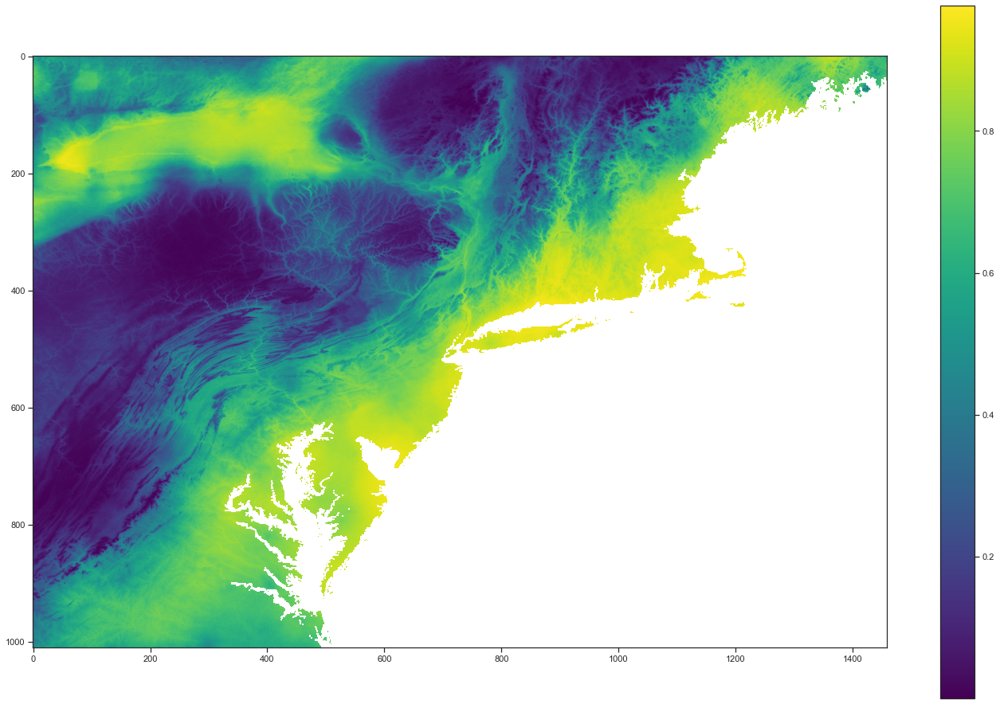

In [47]:
# Plot the Final Product!
# Use the matplotlib qt magic for pan and zoom capabilities!

# %matplotlib qt
%matplotlib inline

plt.figure(figsize=(24,16))

# set na values for the prediction raster
result[result <= 0] = np.nan
plt.imshow(result, cmap='viridis')
plt.colorbar()
plt.show()

## Save the predicted raster to a file

In [ ]:
elev_raster = rasterio.open('./data/output/elev_clip.tif')

print(elev_raster.width, elev_raster.height)
print(elev_raster.shape)
print(elev_raster.count)
print(elev_raster.dtypes)
print(elev_raster.crs)
print(elev_raster.transform)


In [115]:
resultOutput = rasterio.open('./data/SDM_result.tif', "w", driver="GTiff",
                            width=elev_raster.width, height=elev_raster.height,
                            count=1,
                            crs=elev_raster.crs,
                            transform=elev_raster.transform,
                            dtype='float64')

resultOutput.write(result,1)
resultOutput.close()

## Visualizing in Folium for Context
### (in progress)

In [114]:
import rasterio
from rasterio import plot
import folium
import os

# Visualize in folium
elev_raster = rasterio.open('./data/output/elev_clip.tif')

print(elev_raster.width, elev_raster.height)
print(elev_raster.shape)
print(elev_raster.count)
print(elev_raster.dtypes)
print(elev_raster.crs)
print(elev_raster.transform)


1458 1011
(1011, 1458)
1
('int16',)
EPSG:4326
| 0.01, 0.00,-80.10|
| 0.00,-0.01, 44.82|
| 0.00, 0.00, 1.00|


In [113]:
## Use QGIS to convert a geoTIFF float64 to a png 8bit for folium visualization purposes
# expand on this programmatically by using GDAL to convert in python

In [82]:
result.shape

(1011, 1458)

In [88]:
elev_raster.bounds

BoundingBox(left=-80.0958222242269, bottom=36.39615377801378, right=-67.94597725023196, top=44.820046293316935)

In [89]:
xmin=elev_raster.bounds[0] # left bound
xmax=elev_raster.bounds[2] # right bound

ymin=elev_raster.bounds[1] # bottom bound
ymax=elev_raster.bounds[3] # top bound

#Get Central point
centerx=(xmin+xmax)/2
centery=(ymin+ymax)/2

In [99]:
folium_map = folium.Map(location=[centery, centerx],
                        zoom_start=7,
                        tiles='Stamen Terrain'
                       )

image_path = './data/SDM_result.tif'



# img = folium.raster_layers.ImageOverlay(
#     name='SDM for Pitch Pine in the NE U.S.',
#     image=image_path,
#     bounds=[[ymin, xmin], [ymax, xmax]],
#     colormap='viridis',
#     opacity=0.6,
#     interactive=True,
#     cross_origin=False,
#     zindex=1)

img.add_to(folium_map)
# folium.LayerControl().add_to(folium_map)
folium_map.save('./data/SDM_PitchPine_NE.html')

folium_map

# Bioclimatic variables coded as:

BIO1 = Annual Mean Temperature

BIO2 = Mean Diurnal Range (Mean of monthly (max temp - min temp))

BIO3 = Isothermality (BIO2/BIO7) (×100)

BIO4 = Temperature Seasonality (standard deviation ×100)

BIO5 = Max Temperature of Warmest Month

BIO6 = Min Temperature of Coldest Month

BIO7 = Temperature Annual Range (BIO5-BIO6)

BIO8 = Mean Temperature of Wettest Quarter

BIO9 = Mean Temperature of Driest Quarter

BIO10 = Mean Temperature of Warmest Quarter

BIO11 = Mean Temperature of Coldest Quarter

BIO12 = Annual Precipitation

BIO13 = Precipitation of Wettest Month

BIO14 = Precipitation of Driest Month

BIO15 = Precipitation Seasonality (Coefficient of Variation)

BIO16 = Precipitation of Wettest Quarter

BIO17 = Precipitation of Driest Quarter

BIO18 = Precipitation of Warmest Quarter

BIO19 = Precipitation of Coldest Quarter

bio_elev = SRTM derived digital elevation model (30s)


References:
1.	Day, Michael E.; Schedlbauer, Jessica L.; Livingston, William H.; Greenwood, Michael S.; White, Alan S.; Brissette, John C. 2005. Influence of seedbed, light environment, and elevated night temperature on growth and carbon allocation in pitch pine (Pinus rigida) and jack pine (Pinus banksiana) seedlings. Forest Ecology and Management. 205(1-5): 59-71.
2.	Ledig, F. Thomas; Fryer, John H. 1974. Genetics of pitch pine. Research Report WO-27. Washington, DC: U.S. Department of Agriculture, Forest Service. 
3.	Little, Silas; Garrett, Peter W. 1990. Pinus rigida Mill. pitch pine. In: Burns, Russell M.; Honkala, Barbara H., technical coordinators. Silvics of North America. Volume 1. Conifers. Agric. Handb. 654. Washington, DC: U.S. Department of Agriculture, Forest Service: 456-462. 
